# Introduction

This notebook has been initialized thanks to several sources provided around the Home Credit default risk [Kaggle](https://www.kaggle.com/c/home-credit-default-risk) competition: data from Home Credit, Kernels-Notebooks from competitors, Discussions threads involving host and competitors.

While the objective of competitors is to get the best AUC score _Area under the ROC Curve_ by *__any means__*, we'll rather focuse on the ability to provide *__interpretable__* decisions, including the possibility given to customers to explore their case.


# Data

This diagram shows data relationship :

<img src="https://storage.googleapis.com/kaggle-media/competitions/home-credit/home_credit.png" class="svg" alt="" width="700" height="700">

There are 7 different sources of data:
Current application:
* application: details about each `SK_ID_CURR` loan application and applicant + `TARGET` indicating the risk of failure to repay loan on time.
* test: where the `TARGET` has not been calculated yet.

External previous credits information:
* bureau: details about each `SK_ID_BUREAU` client's previous credits oustide our company, with cardinality 1:n from current application.
* bureau_balance: monthly details of each `SK_ID_BUREAU`.
Internal previous credit information:
* previous_application: details about each `SK_ID_PREV` client's previous credits applications within our company, with cardinality 1:n from current application.
* POS_CASH_BALANCE: monthly details of each `SK_ID_PREV` (credits or cash types).
* credit_card_balance: monthly details of each `SK_ID_PREV` (credit cards revolving type).
* installments_payment: payment history of each `SK_ID_PREV`.

Moreover, we are provided with the features definitions (in `HomeCredit_columns_description.csv`). 

In this EDA & FE notebook, we process datasets aggregation in order to get to an intermediate __fully understandable__ dataset, i.e. with any feature dealing with relevant details that could be discussed by counsellor in front of an applicant.
This will surely affect the ability to reach the amazing scores of Kaggle competitors, and it implies to spend additionnal time for the EDA and FE.<br/>
Furthermore, we have to consider this task according to the expectations of the study, which consists in performing __model optimization__ and __model interpretation__. <br/>
This will lead to consider as further optional tasks many EDA & FE ideas, in order to use __model__ and its __interpretation__ bring value in that perspective. <br/>

## Imports

In [1]:
# %load_ext pycodestyle_magic
# %flake8_on
# PEP8 tested
# turn off in case of dataprep.eda use

In [2]:
# numpy and pandas for data manipulation
import numpy as np
import pandas as pd

In [3]:
# eda booster - turn off flake8 to avoid logs
# %flake8_off
from dataprep.eda import plot, plot_correlation, plot_missing

NumExpr defaulting to 4 threads.


In [4]:
# File system manangement
import os

In [5]:
# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
'''
# prepare data
# from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.utils import class_weight
from imblearn.over_sampling import SMOTE
# models and metrics
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import KFold
'''

'\n# prepare data\n# from sklearn.preprocessing import LabelEncoder\nfrom sklearn.preprocessing import MinMaxScaler\nfrom sklearn.impute import SimpleImputer\nfrom sklearn.model_selection import train_test_split\nfrom sklearn.utils import class_weight\nfrom imblearn.over_sampling import SMOTE\n# models and metrics\nfrom sklearn.linear_model import LogisticRegression\nfrom sklearn.ensemble import RandomForestClassifier\nfrom sklearn.metrics import plot_roc_curve\nfrom sklearn.metrics import roc_auc_score\nfrom sklearn.model_selection import KFold\n'

In [7]:
# clean - garbage collection
import gc
gc.enable()

In [8]:
# custom functions
from ipynb.fs.full.functions import agg_numeric, heatmap, missing_values_table, count_categorical, convert_types, one_hot_encoder, label_encoder, target_corrs, kde_plot 

In [9]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

In [10]:
# paramètres
# to display any columns
pd.options.display.max_columns = 122
sns.set(style="ticks")
sns.set_style('whitegrid')

## Read in Data 

First, we can list all the available data files. There are a total of 9 files: 1 main file for training (with target) 1 main file for testing (without the target), 1 example submission file, and 6 other files containing additional information about each loan. 

In [11]:
# List files available
print(os.listdir("Data/"))

['application_test.csv', 'application_train.csv', 'application_trunc.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'Descriptions.xlsx', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'sample_submission.csv']


In [12]:
# first level
application = pd.read_csv('Data/application_train.csv')
test = pd.read_csv('Data/application_test.csv')

In [13]:
# any applications
any_applications = application.append(test).reset_index()

In [14]:
# only ID & target
target = application.filter(['SK_ID_CURR', 'TARGET'])

In [15]:
# second level
bureau = pd.read_csv('Data/bureau.csv')

In [16]:
# second level
previous = pd.read_csv('Data/previous_application.csv')

In [17]:
# third level
credit_balance = pd.read_csv('Data/POS_CASH_balance.csv')

In [18]:
# third level
card_balance = pd.read_csv('Data/credit_card_balance.csv')

In [19]:
''' check overlapping of both sk_id_prev loans'''

' check overlapping of both sk_id_prev loans'

In [20]:
# third level
bureau_balance = pd.read_csv('Data/bureau_balance.csv')

In [21]:
# third level
installments = pd.read_csv('Data/installments_payments.csv')

In [22]:
print(application.shape)
application.head(3)

(307511, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

The training data has 307511 observations (each one a separate loan) and 122 features (variables) including the `TARGET` (the label we want to predict).

In [23]:
print(test.shape)
test.head(3)

(48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.066,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0


In [24]:
print('Test and Train split (test size in % of total):', 
      round(100 * test.shape[0] / (application.shape[0] + test.shape[0]), 2))

Test and Train split (test size in % of total): 13.68


Split train | test is approx 14%

In [25]:
# getting columns descriptions
col_desc = pd.read_csv('Data/HomeCredit_columns_description.csv', encoding= 'unicode_escape')
print('HomeCredit_columns_description: ', col_desc.shape)
col_desc.head()

HomeCredit_columns_description:  (219, 5)


,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


In [26]:
# get the target description
pd.options.display.max_colwidth = len(col_desc[col_desc['Row'] == 'TARGET']['Description'])
col_desc[col_desc['Row'] == 'TARGET']['Description']

1    Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)
Name: Description, dtype: object

# Exploratory Data Analysis & Feature Engineering

## Distribution of the Target Column

Let's rely on the rule as defined : client with payment difficulties means he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample. <br/>
Here, {X, Y} are black-box parameters and they could differ according to the contract types or any other parameters. <br/>
Let's assume that those {Xcash, Ycash} & {Xrevolving, Yrevolving} or even {Xtime, Ytime} values have been adjusted for some good reason, so that learning from known client's failures could help predict future failures, and prevent damages by simply refusing to grant the laon, regardless the financial cost of an effective failure or the benefits.

In [27]:
# failure rate
print('global failure rate: ',
     round(100 * application[application['TARGET'] == 1].shape[0]/application.shape[0], 2))

global failure rate:  8.07


In [28]:
# filtre moins restrictif : bâtiments "résidentiels stricts" et exemples
cols = ['TARGET', 'NAME_CONTRACT_TYPE']
mask_rev = (application['NAME_CONTRACT_TYPE'] == 'Revolving loans')
mask_cash = (application['NAME_CONTRACT_TYPE'] == 'Cash loans')
mask_revfail = (application['TARGET'] == 1) & (application['NAME_CONTRACT_TYPE'] == 'Revolving loans')
mask_cashfail = (application['TARGET'] == 1) & (application['NAME_CONTRACT_TYPE'] == 'Cash loans')
print('Cash loans failure rate: ',
      round(100 * application[cols][mask_cashfail].shape[0] / application[cols][mask_cash].shape[0], 2))
print('Revolving loans failure rate: ',
      round(100 * application[cols][mask_revfail].shape[0] / application[cols][mask_rev].shape[0], 2))

Cash loans failure rate:  8.35
Revolving loans failure rate:  5.48


In [29]:
# stats for target / contract_type cases
application_count = application.groupby(
    ['NAME_CONTRACT_TYPE', 'TARGET'],
    as_index=False).agg({'SK_ID_CURR': ['count']})
application_count.columns = ['NAME_CONTRACT_TYPE',
                           'TARGET',
                           'count']
application_count['TARGET'] = application_count['TARGET'].replace([0, 1], ['Payed', 'Failed'])
application_count['NAME_CONTRACT_TYPE'] = application_count['NAME_CONTRACT_TYPE'].replace(
    ['Cash loans', 'Revolving loans'],
    ['Cash', 'Revolving'])
application_count['case'] =  application_count['TARGET'] + '_' + application_count['NAME_CONTRACT_TYPE']
application_count

,NAME_CONTRACT_TYPE,TARGET,count,case
0,Cash,Payed,255011,Payed_Cash
1,Cash,Failed,23221,Failed_Cash
2,Revolving,Payed,27675,Payed_Revolving
3,Revolving,Failed,1604,Failed_Revolving


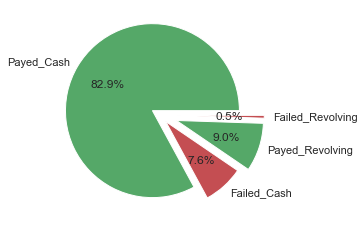

In [30]:
# failure by contract type
explodeList = (0.1, 0.1, 0.2, 0.2)
colorsList = ('g', 'r', 'g', 'r') 
plt.pie(application_count['count'],
        explode=explodeList,
        colors=colorsList,
        labels=application_count['case'],
        autopct='%1.1f%%')
plt.savefig("pie.png") 

## Contract types & Credits amounts

We check amounts & types from each of the 3 sources.

In [31]:
# case current application : loans amounts
plot(any_applications, "AMT_CREDIT", "NAME_CONTRACT_TYPE")

We'll deal later with outliers: application amount above a given threshold would surely require more attention by the company. <br/>
We can observe that Cash loans application involve higher amounts.

In [32]:
print(previous.shape[0])
print(len(previous['SK_ID_PREV'].unique()))

1670214
1670214


In [33]:
# case previous applications, loans amounts
plot(previous, "AMT_CREDIT", 'NAME_CONTRACT_TYPE')

In [34]:
# get previous internal loans count
previous_loan_counts = previous.groupby(
    'SK_ID_CURR',
    as_index=False)['SK_ID_PREV'].count().rename(columns={'SK_ID_PREV': 'N_CNT_PREV_LOANS'})
any_applications = any_applications.merge(previous_loan_counts, on='SK_ID_CURR', how='left')

Previous applications let appear the 3rd contract type 'consumer loans' with smaller GOODS_PRICE: we would consider those loans as a subpart of Cash loans.


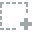
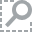
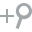
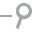
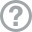
...
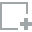
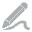
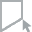
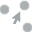
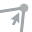

In [35]:
# case of external loans from "Credit Bureau"
plot(bureau, 'CREDIT_TYPE')

The largest value (Consumer credit) is over 3 times larger than the second largest value (Credit card)

Bureau applications let appear many other contract types, mainly due to the detailed purpose & context of the application. We should merge first to dig deeper, then eventually grouping relevant new types into application subset : basically we would consider only Credit Card as Revolving credits, and others as Cash + Consumer credits.

In [36]:
# clip by Mortgage upper whisker for line chart view
plot(bureau[bureau['AMT_CREDIT_SUM'] < 2500000], "AMT_CREDIT_SUM", 'CREDIT_TYPE')

In [37]:
# get previous external loans count
bureau_loan_counts = bureau.groupby(
    'SK_ID_CURR',
    as_index=False)['SK_ID_BUREAU'].count().rename(columns={'SK_ID_BUREAU': 'N_CNT_BUR_LOANS'})
any_applications = any_applications.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')

In [38]:
# get the total count of loans
any_applications['N_CNT_BUR_LOANS'] = any_applications['N_CNT_BUR_LOANS'].fillna(0)
any_applications['N_CNT_PREV_LOANS'] = any_applications['N_CNT_PREV_LOANS'].fillna(0)
any_applications['N_CNT_TOT_LOANS'] = any_applications['N_CNT_BUR_LOANS'] + any_applications['N_CNT_PREV_LOANS']


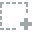
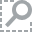
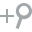
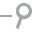
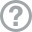
...
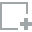
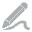
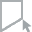
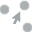
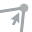

In [39]:
plot(any_applications['N_CNT_TOT_LOANS'])

In [40]:
print(round(100 * any_applications[any_applications['N_CNT_BUR_LOANS'] == 0].shape[0]/any_applications.shape[0], 2))
print(round(100 * any_applications[any_applications['N_CNT_PREV_LOANS'] == 0].shape[0]/any_applications.shape[0], 2))
print(round(100 * any_applications[any_applications['N_CNT_TOT_LOANS'] == 0].shape[0]/any_applications.shape[0], 2))

14.16
4.88
0.75


In [41]:
test = test.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
test = test.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
test['N_CNT_BUR_LOANS'] = test['N_CNT_BUR_LOANS'].fillna(0)
test['N_CNT_PREV_LOANS'] = test['N_CNT_PREV_LOANS'].fillna(0)
test['N_CNT_TOT_LOANS'] = test['N_CNT_BUR_LOANS'] + test['N_CNT_PREV_LOANS']

In [42]:
application = application.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
application = application.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
application['N_CNT_BUR_LOANS'] = application['N_CNT_BUR_LOANS'].fillna(0)
application['N_CNT_PREV_LOANS'] = application['N_CNT_PREV_LOANS'].fillna(0)
application['N_CNT_TOT_LOANS'] = application['N_CNT_BUR_LOANS'] + application['N_CNT_PREV_LOANS']

In [43]:
print(test[test['N_CNT_TOT_LOANS'] == 0].shape[0])
print(application[application['N_CNT_TOT_LOANS'] == 0].shape[0])

208
2470


In [44]:
print('rate of unknown applicants, test set: ',
      round(100 * test[test['N_CNT_TOT_LOANS'] == 0].shape[0] / test.shape[0], 2))

rate of unknown applicants, test set:  0.43


In [45]:
print('rate of unknown applicants, train set: ',
      round(100 * application[application['N_CNT_TOT_LOANS'] == 0].shape[0] / application.shape[0], 2))

rate of unknown applicants, train set:  0.8


## Monthly balance

We go one level deeper with x_balance datasets, containing monthly balances of any credit.

In [46]:
sk_prev_ids = previous['SK_ID_PREV'].unique()
print(len(sk_prev_ids))

1670214


In [47]:
# how many previous loans have their installments details & of previous
ins_sk_prev_ids = installments['SK_ID_PREV'].unique()
print(len(ins_sk_prev_ids))
print(len(set(ins_sk_prev_ids).intersection(set(sk_prev_ids))))

997752
958905


In [48]:
# how many previous loans have their credit balance details & of previous
credit_sk_prev_ids = credit_balance['SK_ID_PREV'].unique()
print(len(credit_sk_prev_ids))
print(len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids))))

936325
898903


In [49]:
# how many previous loans have their card balance details & of previous
card_sk_prev_ids = card_balance['SK_ID_PREV'].unique()
print(len(card_sk_prev_ids))
print(len(set(card_sk_prev_ids).intersection(set(sk_prev_ids))))

104307
92935


! there are numerous installments, credit or card balance details of previous credit not in the df previous

In [50]:
# check if no common sk_id between credit and card balance
common_sk_prev_ids = list(set(credit_sk_prev_ids).intersection(set(card_sk_prev_ids)))
len(common_sk_prev_ids)

0

In [123]:
# how many previous loans doesnt't have card nor credit details
a = len(set(card_sk_prev_ids).intersection(set(sk_prev_ids)))
b = len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids)))
print(len(sk_prev_ids) - (a + b))

678376


In [51]:
# how many credits balances have installments details, of overall
ins_cred_sk_prev_ids = list(set(ins_sk_prev_ids).intersection(set(credit_sk_prev_ids)))
print(len(ins_cred_sk_prev_ids))
print(len(credit_sk_prev_ids) - len(ins_cred_sk_prev_ids))

924949
11376


In [52]:
# how many card balances have installments details, of overall
ins_card_sk_prev_ids = list(set(ins_sk_prev_ids).intersection(set(card_sk_prev_ids)))
print(len(ins_card_sk_prev_ids))
print(len(card_sk_prev_ids) - len(ins_card_sk_prev_ids))

72466
31841


There is an inconsistency between the previous loans level of detail and the 3 sub-level sources of detail : therefore, to keep any valuable information from any of the 4 files, we'll have to find a way to skip the merge with previous loans and rather gather on SK_ID_CURR. 


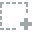
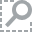
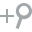
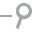
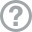
...
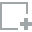
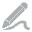
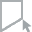
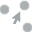
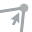

In [53]:
# monthly balance of the Bureau Credits
plot(bureau_balance['STATUS'], progress=False)

Basically we get here to the complete story of external loans (well, considering X - unknow info for 21,28% of months balance) : <br/>
- C status measures the credit closing AGE in months (DAYS_ENDDATE_FACT in bureau), and any others gives the TERM,
- STATUS from 1-30 days (1) to over 120 days (5) provide the knowledge of clients failure and how deep considering the value of STATUS,
- Failure in early installments could be somehow accessible : the minimal month number where occurs a failure, i.e. with STATUS in [1, 5].


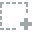
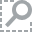
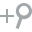
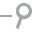
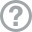
...
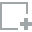
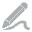
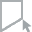
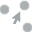
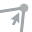

In [54]:
# same with credit balance
plot(credit_balance['NAME_CONTRACT_STATUS'], progress=False)

Opposite to Bureau credits, those contracts are mainly in an Active STATUS (not 'Completed' : closed), 'previous' will provide the right value.


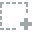
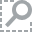
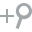
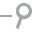
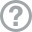
...
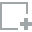
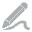
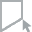
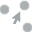
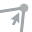

In [55]:
plot(credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0], 'NAME_CONTRACT_STATUS')

In [56]:
focus_credit = credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0]
focus_credit = focus_credit[focus_credit['NAME_CONTRACT_STATUS'] == 'Active']

In [57]:
focus_credit.sample(3)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
9452877,1053069,163113,-22,10.0,0.0,Active,2230,0
9893202,2009997,337375,-57,12.0,0.0,Active,170,0
7164486,1075596,376882,-70,10.0,0.0,Active,86,0


We got here the case of contracts still Active while there is no future installment : here closed by full payment before term. Let's see how 'previous' application table deal with it.

Contracts could remain in Active STATUS while actualy Completed by anticipation.

In [58]:
# Credit and Card balance
print('failure ratio : ' + str(
    credit_balance[credit_balance['SK_DPD_DEF'] > 0].shape[0] / credit_balance.shape[0]))
credit_balance[credit_balance['SK_DPD_DEF'] > 0].sample(3)

failure ratio : 0.011395352511128989


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
4557275,2478599,346643,-23,24.0,19.0,Active,2,2
3479733,2399230,383585,-60,8.0,2.0,Active,25,25
735157,1984689,200579,-24,6.0,5.0,Active,1,1


SK_DPD & SK_DPD_DEF contains over 1,1% of monthly failure - with DPD in days and a "tolerance" is applied to build SK_DPD_DEF, in case of small amounts.

[ProgressBar] ProgressBar takes additional 10%+ of the computation time, consider disable it by passing 'progress=False' to the plot function.



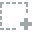
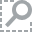
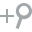
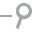
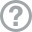
...
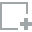
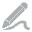
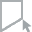
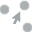
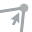

In [59]:
# same with card balance
plot(card_balance, 'NAME_CONTRACT_STATUS')

Again we observe an abnormal Active STATUS.

We won't ge deeper in that path, because we would rather get a similar info from both types of credits, and it represents too much additionnal effort to master this special credit card behavior.

## Bottom Up aggregation

In [16]:
'''
print('previous :')
previous = convert_types(previous, print_info=True)
print('application :')
application = convert_types(application, print_info=True)
print('bureau_balance :')
bureau_balance = convert_types(bureau_balance, print_info=True)
print('bureau :')
bureau = convert_types(bureau, print_info=True)
print('credit_balance :')
credit_balance = convert_types(credit_balance, print_info=True)
print('card_balance :')
card_balance = convert_types(card_balance, print_info=True)
print('installments :')
installments = convert_types(installments, print_info=True)
'''

previous :
Original Memory Usage: 0.49 gb.
New Memory Usage: 0.18 gb.
application :
Original Memory Usage: 0.3 gb.
New Memory Usage: 0.17 gb.
bureau_balance :
Original Memory Usage: 0.66 gb.
New Memory Usage: 0.35 gb.
bureau :
Original Memory Usage: 0.23 gb.
New Memory Usage: 0.13 gb.
credit_balance :
Original Memory Usage: 0.64 gb.
New Memory Usage: 0.41 gb.
card_balance :
Original Memory Usage: 0.71 gb.
New Memory Usage: 0.42 gb.
installments :
Original Memory Usage: 0.87 gb.
New Memory Usage: 0.49 gb.


### Aggregate over Installments

While every payments are detailed over any previous application SK_ID_PREV, what matters for us, somehow already accessible through both credit balance or card balance with SK_DPD, is the rough info where (i.e. when and how much) a client failed to pay the installement.

In [60]:
installments.head(10)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585
5,1137312,164489,1.0,12,-1384.0,-1417.0,5970.375,5970.375
6,2234264,184693,4.0,11,-349.0,-352.0,29432.295,29432.295
7,1818599,111420,2.0,4,-968.0,-994.0,17862.165,17862.165
8,2723183,112102,0.0,14,-197.0,-197.0,70.740,70.740
9,1413990,109741,1.0,4,-570.0,-609.0,14308.470,14308.470


In [61]:
# alternate option would be to put that missing info as X_STATUS
installments.dropna(inplace=True)

Let's catch overdue in time and amount :

In [62]:
# manual FE installements
# overdue amounts
installments['N_INS_AMT_OVERDUE'] = installments['AMT_INSTALMENT'] - installments['AMT_PAYMENT']
installments['N_INS_AMT_OVERDUE'] = installments['N_INS_AMT_OVERDUE'].apply(lambda x: x if x > 0 else 0)
# prepayed amounts
installments['N_INS_AMT_PREPAYED'] = installments['AMT_PAYMENT'] - installments['AMT_INSTALMENT']
installments['N_INS_AMT_PREPAYED'] = installments['N_INS_AMT_PREPAYED'].apply(lambda x: x if x > 0 else 0)
# overdue ratio
installments['N_AMT_OVERDUE_RATIO'] = installments['N_INS_AMT_OVERDUE'] / (1 + installments['AMT_INSTALMENT'])
# with positive values to get a match with SK_DPD
installments['N_INS_DPD'] = installments['DAYS_ENTRY_PAYMENT'] - installments['DAYS_INSTALMENT']
installments['N_INS_DPD'] = installments['N_INS_DPD'].apply(lambda x: x if x > 0 else 0)
# same with DBD Before Due may be somehow valuable
installments['N_INS_DBD'] = installments['DAYS_INSTALMENT'] - installments['DAYS_ENTRY_PAYMENT']
installments['N_INS_DBD'] = installments['N_INS_DBD'].apply(lambda x: x if x > 0 else 0)
# DPD categories to get a match with Bureau data
bins = [-np.inf, 1, 30, 60, 90, 120, np.inf]
values = ['0', '1', '2', '3', '4', '5']
installments['N_STATUS'] = pd.cut(installments['N_INS_DPD'], bins, labels=values)

In [129]:
# to get earliness of overdue we need to catch min of NUM_INSTALMENT_NUMBER out of !=0 N_STATUS
focus_installments = installments[installments['N_STATUS'] != '0']
focus_installments_agg = focus_installments.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'NUM_INSTALMENT_NUMBER': ['min']})
focus_installments_agg.columns = [
    'SK_ID_PREV',
    'INS_N_PREV_EARLIER_OVERDUE']

In [64]:
focus_installments.head(3)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT,N_INS_AMT_OVERDUE,N_INS_AMT_PREPAYED,N_AMT_OVERDUE_RATIO,N_INS_DPD,N_INS_DBD,N_STATUS
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585,4.455,0.0,0.002057,17.0,0.0,1
19,2329072,183463,1.0,11,-1699.0,-1693.0,7283.295,7283.295,0.000,0.0,0.000000,6.0,0.0,1
30,1840786,175114,1.0,11,-476.0,-474.0,21179.700,21161.700,18.000,0.0,0.000850,2.0,0.0,1


The less this "earlier overdue" is, the more is the risk of failure. But from Null value point of view, we won't be able to set a right replacement value for clients with no overdue at all : let's first consider other aggregative data to compute a valid overdue earliness index.

In [130]:
# compute valuable features by SK_ID_PREV
installments_agg = installments.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'NUM_INSTALMENT_VERSION': ['max'],
     'N_INS_AMT_OVERDUE': ['max'],
     'NUM_INSTALMENT_NUMBER': ['max'],
     'DAYS_INSTALMENT': ['max']})
installments_agg.columns = [
    'SK_ID_PREV',
    'INS_N_PREV_CNT_PROLONG',
    'INS_N_PREV_INS_AMT_MAX_OVERDUE',
    'INS_N_PREV_CNT_TOT_INSTALMENT',
    'INS_N_PREV_LAST_DAYS_INSTALMENT']

In [131]:
# merge with raw earlier overdue
installments_agg = installments_agg.merge(focus_installments_agg, how='left', on='SK_ID_PREV')
# we compute a ratio with ability to fill Null with Zero after aggregation
installments_agg['INS_N_PREV_EARLINESS_OVERDUE_RATIO'] = 1 - installments_agg['INS_N_PREV_EARLIER_OVERDUE'] / installments_agg['INS_N_PREV_CNT_TOT_INSTALMENT']
installments_agg.drop(columns=['INS_N_PREV_EARLIER_OVERDUE'], inplace=True)
installments_agg['INS_N_PREV_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)
installments_agg['INS_N_PREV_LOAN_AGE'] = - installments_agg['INS_N_PREV_LAST_DAYS_INSTALMENT'] / 365

In [67]:
installments_agg.head(3)

,SK_ID_PREV,INS_N_PREV_CNT_PROLONG,INS_N_PREV_INS_AMT_MAX_OVERDUE,INS_N_PREV_CNT_TOT_INSTALMENT,INS_N_PREV_LAST_DAYS_INSTALMENT,INS_N_PREV_EARLINESS_OVERDUE_RATIO,INS_N_PREV_LOAN_AGE
0,1000001,2.0,0.0,2,-238.0,0.0,0.652055
1,1000002,2.0,0.0,4,-1510.0,0.0,4.136986
2,1000003,1.0,0.0,3,-34.0,0.0,0.093151


installments_agg will be merged later to SK_ID_PREV

In [68]:
# check any missing values
installments.isna().sum()

SK_ID_PREV                0
SK_ID_CURR                0
NUM_INSTALMENT_VERSION    0
NUM_INSTALMENT_NUMBER     0
DAYS_INSTALMENT           0
DAYS_ENTRY_PAYMENT        0
AMT_INSTALMENT            0
AMT_PAYMENT               0
N_INS_AMT_OVERDUE         0
N_INS_AMT_PREPAYED        0
N_AMT_OVERDUE_RATIO       0
N_INS_DPD                 0
N_INS_DBD                 0
N_STATUS                  0
dtype: int64

In [69]:
# object type represents category
installments['N_STATUS'] = installments['N_STATUS'].astype('object')

In [70]:
# Preprocess installments_payments.csv
def installments_payments(ins, num_rows=None, nan_as_category=False):
    ins, cat_cols = one_hot_encoder(ins, nan_as_category=False)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['max', 'nunique'],
        'NUM_INSTALMENT_NUMBER': ['max'],
        'DAYS_INSTALMENT': ['mean'],
        'N_INS_DPD': ['max', 'mean', 'sum'],
        'N_INS_DBD': ['max', 'mean', 'sum'],
        'N_INS_AMT_OVERDUE': ['max', 'mean', 'sum'],
        'N_INS_AMT_PREPAYED' : ['max', 'mean', 'sum'],
        'N_AMT_OVERDUE_RATIO': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['min', 'max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean', 'sum']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INS_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INS_N_INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    gc.enable()
    del ins
    gc.collect()
    return ins_agg

In [71]:
# installements FE by SK_ID
sk_id_installments = installments_payments(installments, num_rows=None)

In [72]:
# merge to target for corr study
ins_target = target.join(sk_id_installments, how='left', on='SK_ID_CURR')
ins_target_corrs = target_corrs(ins_target)

In [74]:
# corrs study
ins_target_corrs.head(10)

,feature,abs_corr
31,INS_N_STATUS_0_MEAN,0.070791
33,INS_N_STATUS_1_MEAN,0.069609
18,INS_N_AMT_OVERDUE_RATIO_MEAN,0.063052
20,INS_N_AMT_OVERDUE_RATIO_VAR,0.060350
27,INS_DAYS_ENTRY_PAYMENT_MIN,0.058794
17,INS_N_AMT_OVERDUE_RATIO_MAX,0.045680
29,INS_DAYS_ENTRY_PAYMENT_MEAN,0.043992
4,INS_DAYS_INSTALMENT_MEAN,0.043423
12,INS_N_INS_AMT_OVERDUE_MEAN,0.037576
30,INS_DAYS_ENTRY_PAYMENT_SUM,0.035225


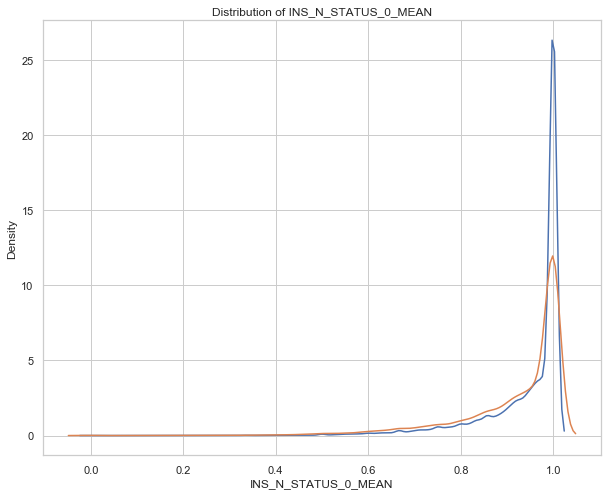

In [75]:
# most interesting feature study through plot
kde_plot(ins_target, 'INS_N_STATUS_0_MEAN')

In [76]:
ins_target.isna().sum().head(3)

SK_ID_CURR                        0    
TARGET                            0    
INS_NUM_INSTALMENT_VERSION_MAX    15876
dtype: int64

Those installments aggregative data produce missing values once merged with SK_ID, meaning we have no previous internal knowledge about those clients before application.
N_INS_INSTAL_COUNT is therefore zero for those 15876 SK_ID.

### Aggregate over Credit balance

Credit card brings much more complex features to handle than credit, mainly because the client could use it (or not) in many ways. To get straight to the point, we'll try to catch and keep only the big picture.

In [77]:
credit_balance.sample(3)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
906490,2123075,426852,-15,12.0,11.0,Active,0,0
5125463,1326986,237166,-21,36.0,29.0,Active,0,0
2266869,2671005,438465,-92,8.0,2.0,Active,0,0


In [78]:
credit_balance.dropna(inplace=True)

In [79]:
focus_credit_balance = credit_balance[credit_balance['NAME_CONTRACT_STATUS'] == 'Active']

In [80]:
dpd_count = focus_credit_balance[focus_credit_balance['SK_DPD'] != 0].shape[0]
dpd_def_count = focus_credit_balance[focus_credit_balance['SK_DPD_DEF'] != 0].shape[0]
print('dpd_def tolerance filtering ratio: %f' %(dpd_def_count/dpd_count))

dpd_def tolerance filtering ratio: 0.393702


Almost 40% of actual overdue are filtered, due to low laon amounts ignored.

In [81]:
# get loan age - in months and term for each previous loan
focus_credit_balance = credit_balance[credit_balance['NAME_CONTRACT_STATUS'] == 'Active']
focus_credit_balance_agg = focus_credit_balance.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'MONTHS_BALANCE': ['min'],
     'CNT_INSTALMENT': ['size']})
focus_credit_balance_agg.columns = [
    'SK_ID_PREV',
    'POS_N_PREV_LOAN_AGE_MONTH',
    'POS_N_PREV_LOAN_TERM']
focus_credit_balance.drop(columns=['NAME_CONTRACT_STATUS'], inplace=True)

In [82]:
# to get earliness of DPD overdue we need to catch min of CNT_INSTALMENT with SK_DPD > 0
dpd_credit_balance = focus_credit_balance[focus_credit_balance['SK_DPD'] != 0]
dpd_credit_balance_agg = dpd_credit_balance.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'CNT_INSTALMENT': ['min']})
dpd_credit_balance_agg.columns = [
    'SK_ID_PREV',
    'POS_N_DPD_PREV_EARLIER_OVERDUE']

In [83]:
# to get earliness of DPD_DEF overdue we need to catch min of CNT_INSTALMENT with SK_DPD_DEF > 0
dpd_def_credit_balance = focus_credit_balance[focus_credit_balance['SK_DPD_DEF'] != 0]
dpd_def_credit_balance_agg = dpd_def_credit_balance.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'CNT_INSTALMENT': ['min']})
dpd_def_credit_balance_agg.columns = [
    'SK_ID_PREV',
    'POS_N_DPD_DEF_PREV_EARLIER_OVERDUE']

In [84]:
# merge with raw earlier overdue
credit_balance_agg = focus_credit_balance_agg.merge(dpd_credit_balance_agg, how='left', on='SK_ID_PREV')
credit_balance_agg = credit_balance_agg.merge(dpd_def_credit_balance_agg, how='left', on='SK_ID_PREV')

In [85]:
credit_balance_agg['POS_N_DPD_PREV_EARLINESS_OVERDUE_RATIO'] = 1 - credit_balance_agg['POS_N_DPD_PREV_EARLIER_OVERDUE'] / credit_balance_agg['POS_N_PREV_LOAN_TERM']
credit_balance_agg.drop(columns=['POS_N_DPD_PREV_EARLIER_OVERDUE'], inplace=True)
credit_balance_agg['POS_N_DPD_PREV_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)
credit_balance_agg['POS_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO'] = 1 - credit_balance_agg['POS_N_DPD_DEF_PREV_EARLIER_OVERDUE'] / credit_balance_agg['POS_N_PREV_LOAN_TERM']
credit_balance_agg.drop(columns=['POS_N_DPD_DEF_PREV_EARLIER_OVERDUE'], inplace=True)
credit_balance_agg['POS_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)
credit_balance_agg['POS_N_PREV_LOAN_AGE'] = - credit_balance_agg['POS_N_PREV_LOAN_AGE_MONTH'] / 12

credit_balance_agg will be merged later with other SK_ID_PREV aggregations into SK_ID_CURR (skiping SK_ID_PREV)

In [86]:
# Preprocess POS_CASH_balance.csv
def pos_cash(pos,num_rows = None, nan_as_category=False):
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean'],
        'SK_DPD': ['min', 'max', 'mean'],
        'SK_DPD_DEF': ['min', 'max', 'mean']
    }
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_N_POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    gc.enable()
    del pos
    gc.collect()
    return pos_agg

In [87]:
sk_id_focus_credit_balance = pos_cash(focus_credit_balance, num_rows=None)

In [184]:
sk_id_focus_credit_balance.columns

Index(['POS_MONTHS_BALANCE_MAX', 'POS_MONTHS_BALANCE_MEAN', 'POS_SK_DPD_MIN',
       'POS_SK_DPD_MAX', 'POS_SK_DPD_MEAN', 'POS_SK_DPD_DEF_MIN',
       'POS_SK_DPD_DEF_MAX', 'POS_SK_DPD_DEF_MEAN', 'POS_N_POS_COUNT'],
      dtype='object')

In [88]:
# merge to target for corr study
pos_target = target.join(sk_id_focus_credit_balance, how='left', on='SK_ID_CURR')
target_corrs(pos_target)

,feature,abs_corr
9,POS_N_POS_COUNT,0.035816
2,POS_MONTHS_BALANCE_MEAN,0.033448
7,POS_SK_DPD_DEF_MAX,0.018046
8,POS_SK_DPD_DEF_MEAN,0.009336
1,POS_MONTHS_BALANCE_MAX,0.005359
3,POS_SK_DPD_MIN,0.004939
5,POS_SK_DPD_MEAN,0.004899
4,POS_SK_DPD_MAX,0.004256
6,POS_SK_DPD_DEF_MIN,0.003984
0,SK_ID_CURR,0.002108


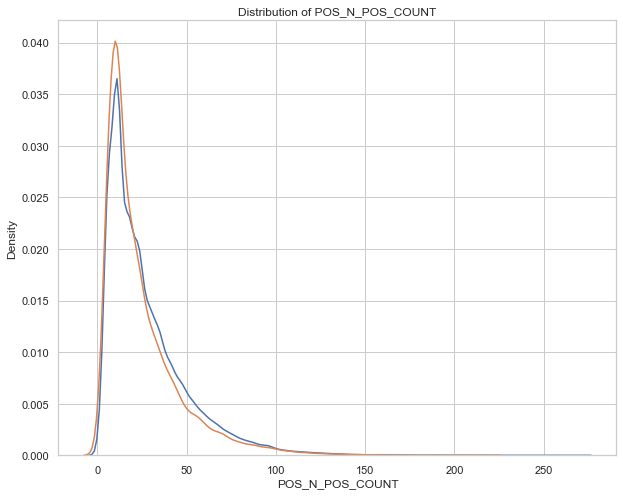

In [89]:
# most interesting feature study through plot
kde_plot(pos_target, 'POS_N_POS_COUNT')

### Aggregate over Card balance

In [90]:
card_balance.sample(3)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
1384740,1211215,376628,-5,0.0,0,0.0,0.0,0.0,0.0,0.0,202.5,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,46.0,Active,0,0
2615527,1285282,252776,-72,0.0,135000,0.0,0.0,0.0,0.0,0.0,1957.5,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,4.0,Active,0,0
3449438,1154103,347903,-7,0.0,1125000,NaN,0.0,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,0.0,Active,0,0



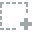
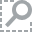
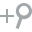
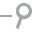
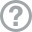
...
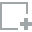
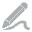
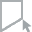
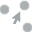
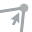

In [91]:
plot_missing(card_balance)

In [92]:
card_balance.fillna(0)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.00,1800.000,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.00,2250.000,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.00,2250.000,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.00,11925.000,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.00,27000.000,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3840307,1036507,328243,-9,0.000,45000,0.0,0.0,0.0,0.0,0.000,0.00,0.000,0.000,0.000,0.000,0.0,0,0.0,0.0,0.0,Active,0,0
3840308,1714892,347207,-9,0.000,45000,0.0,0.0,0.0,0.0,0.000,1879.11,0.000,0.000,0.000,0.000,0.0,0,0.0,0.0,23.0,Active,0,0
3840309,1302323,215757,-9,275784.975,585000,270000.0,270000.0,0.0,0.0,2250.000,375750.00,356994.675,269356.140,273093.975,273093.975,2.0,2,0.0,0.0,18.0,Active,0,0
3840310,1624872,430337,-10,0.000,450000,0.0,0.0,0.0,0.0,0.000,0.00,0.000,0.000,0.000,0.000,0.0,0,0.0,0.0,0.0,Active,0,0


In [93]:
focus_card_balance = card_balance[card_balance['NAME_CONTRACT_STATUS'] == 'Active']

In [94]:
card_dpd_count = focus_card_balance[focus_card_balance['SK_DPD'] != 0].shape[0]
card_dpd_def_count = focus_card_balance[focus_card_balance['SK_DPD_DEF'] != 0].shape[0]
print('dpd_def tolerance filtering ratio: ',
      round(100 * (card_dpd_def_count/card_dpd_count), 2))

dpd_def tolerance filtering ratio:  57.89


Tolerance level seems higher for credit card overdue.

In [95]:
# get loan age - in months and term for each previous loan
focus_card_balance_agg = focus_card_balance.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'MONTHS_BALANCE': ['min', 'size']})
focus_card_balance_agg.columns = [
    'SK_ID_PREV',
    'CC_N_PREV_LOAN_AGE_MONTH',
    'CC_N_PREV_LOAN_TERM']
focus_card_balance.drop(columns=['NAME_CONTRACT_STATUS'], inplace=True)

In [96]:
# to get earliness of DPD overdue we need to catch min of CNT_INSTALMENT with SK_DPD > 0
dpd_card_balance = focus_card_balance[focus_card_balance['SK_DPD'] != 0]
dpd_card_balance_agg = dpd_card_balance.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'MONTHS_BALANCE': ['min']})
dpd_card_balance_agg.columns = [
    'SK_ID_PREV',
    'CC_N_DPD_PREV_EARLIER_OVERDUE']

In [97]:
# to get earliness of DPD_DEF overdue we need to catch min of CNT_INSTALMENT with SK_DPD_DEF > 0
dpd_def_card_balance = focus_card_balance[focus_card_balance['SK_DPD_DEF'] != 0]
dpd_def_card_balance_agg = dpd_def_card_balance.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'MONTHS_BALANCE': ['min']})
dpd_def_card_balance_agg.columns = [
    'SK_ID_PREV',
    'CC_N_DPD_DEF_PREV_EARLIER_OVERDUE']

In [98]:
# merge with raw earlier overdue
card_balance_agg = focus_card_balance_agg.merge(dpd_card_balance_agg, how='left', on='SK_ID_PREV')
card_balance_agg = card_balance_agg.merge(dpd_def_card_balance_agg, how='left', on='SK_ID_PREV')

In [99]:
card_balance_agg.head(3)

,SK_ID_PREV,CC_N_PREV_LOAN_AGE_MONTH,CC_N_PREV_LOAN_TERM,CC_N_DPD_PREV_EARLIER_OVERDUE,CC_N_DPD_DEF_PREV_EARLIER_OVERDUE
0,1000018,-6,5,NaN,NaN
1,1000030,-8,8,NaN,NaN
2,1000031,-16,16,NaN,NaN


In [100]:
card_balance_agg['CC_N_DPD_PREV_EARLINESS_OVERDUE_RATIO'] = 1 + card_balance_agg['CC_N_DPD_PREV_EARLIER_OVERDUE'] / card_balance_agg['CC_N_PREV_LOAN_TERM']
card_balance_agg.drop(columns=['CC_N_DPD_PREV_EARLIER_OVERDUE'], inplace=True)
card_balance_agg['CC_N_DPD_PREV_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)
card_balance_agg['CC_N_DPD_PREV_EARLINESS_OVERDUE_RATIO'] = card_balance_agg['CC_N_DPD_PREV_EARLINESS_OVERDUE_RATIO'].apply(lambda x: x if x > 0 else 0)
card_balance_agg['CC_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO'] = 1 + card_balance_agg['CC_N_DPD_DEF_PREV_EARLIER_OVERDUE'] / card_balance_agg['CC_N_PREV_LOAN_TERM']
card_balance_agg.drop(columns=['CC_N_DPD_DEF_PREV_EARLIER_OVERDUE'], inplace=True)
card_balance_agg['CC_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)
card_balance_agg['CC_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO'] = card_balance_agg['CC_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO'].apply(lambda x: x if x > 0 else 0)
card_balance_agg['CC_N_PREV_LOAN_AGE'] = - card_balance_agg['CC_N_PREV_LOAN_AGE_MONTH'] / 12

card_balance_agg will be merged later with other SK_ID_PREV aggregations into SK_ID_CURR (skiping SK_ID_PREV)

In [101]:
# get late use by applicant of any credit card (max of drawing amount / credit_limit)
last_month = -2 
late_card_use = card_balance[card_balance['MONTHS_BALANCE'] >= last_month]
late_card_use['N_CC_USE'] = late_card_use['AMT_BALANCE'] / late_card_use['AMT_CREDIT_LIMIT_ACTUAL']
late_card_use = late_card_use.groupby(
    'SK_ID_CURR'
)['N_CC_USE'].max().reset_index().rename(
    columns={'N_CC_USE': 'N_CC_USE_LATE_MONTH_'+str(last_month*-1)})

In [102]:
late_card_use[late_card_use['N_CC_USE_LATE_MONTH_2'] > 0].shape[0]

36755

In [103]:
late_card_use.isna().sum()

SK_ID_CURR               0    
N_CC_USE_LATE_MONTH_2    20935
dtype: int64

In [104]:
late_card_use['N_CC_USE_LATE_MONTH_2'].fillna(0, inplace=True)

late_card_use will be merged later with other CC features on SK_ID_CURR

In [105]:
# Preprocess credit_card_balance.csv
def credit_card_balance(cc, num_rows = None, nan_as_category = True):
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['N_CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg

In [106]:
sk_id_card_balance = credit_card_balance(card_balance, num_rows=None)

In [107]:
# merge with late_card_use
sk_id_card_balance = sk_id_card_balance.merge(late_card_use, how='left', on='SK_ID_CURR')


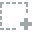
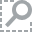
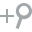
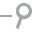
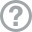
...
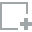
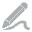
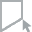
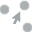
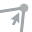

In [108]:
plot_missing(sk_id_card_balance)

In [109]:
sk_id_card_balance['N_CC_USE_LATE_MONTH_2'].fillna(0, inplace=True)

In [110]:
# merge to target for corr study
cc_target = target.merge(sk_id_card_balance, how='left', on='SK_ID_CURR')

In [111]:
cc_corrs = target_corrs(cc_target)

In [112]:
cc_corrs.head(50)

,feature,abs_corr
68,CC_CNT_DRAWINGS_ATM_CURRENT_MEAN,0.107692
72,CC_CNT_DRAWINGS_CURRENT_MAX,0.101389
8,CC_AMT_BALANCE_MEAN,0.087177
63,CC_AMT_TOTAL_RECEIVABLE_MEAN,0.086490
58,CC_AMT_RECIVABLE_MEAN,0.086478
53,CC_AMT_RECEIVABLE_PRINCIPAL_MEAN,0.086062
73,CC_CNT_DRAWINGS_CURRENT_MEAN,0.082520
38,CC_AMT_INST_MIN_REGULARITY_MEAN,0.073724
82,CC_CNT_DRAWINGS_POS_CURRENT_MAX,0.068942
7,CC_AMT_BALANCE_MAX,0.068798


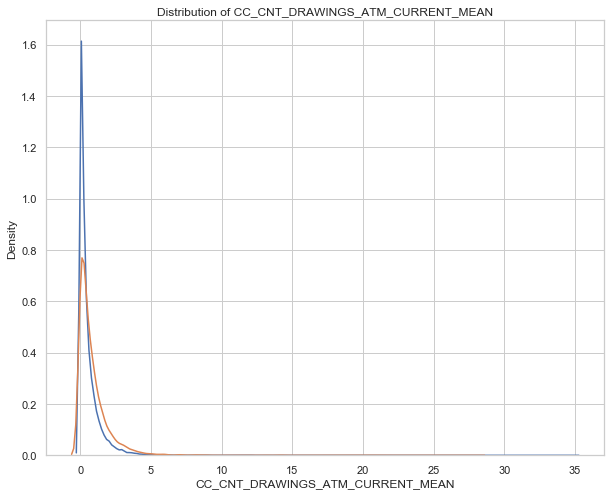

In [114]:
# most interesting feature study through plot
kde_plot(cc_target, 'CC_CNT_DRAWINGS_ATM_CURRENT_MEAN')

### Aggregate "over" Previous credits

There are many inconsistencies between the previous loans and the 3 sources of balance / installments details. We decide to skip merge with previous but compute an SK_ID_CURR aggregation.

In [132]:
installments_agg.columns

Index(['SK_ID_PREV', 'INS_N_PREV_CNT_PROLONG',
       'INS_N_PREV_INS_AMT_MAX_OVERDUE', 'INS_N_PREV_CNT_TOT_INSTALMENT',
       'INS_N_PREV_LAST_DAYS_INSTALMENT', 'INS_N_PREV_EARLINESS_OVERDUE_RATIO',
       'INS_N_PREV_LOAN_AGE'],
      dtype='object')

In [133]:
previous = previous.merge(
    installments_agg,
    how='left',
    on='SK_ID_PREV')

In [134]:
sk_id_installments_agg = installments_agg.merge(
    installments.filter(['SK_ID_CURR', 'SK_ID_PREV']),
    how='left',
    on='SK_ID_PREV')

In [135]:
# Preprocess installments_agg 
def installments_agg(ins, num_rows = None, nan_as_category = True):
    # General aggregations
    ins.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    ins_agg = ins.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    ins_agg.columns = pd.Index(['INSAGG_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    del ins
    gc.collect()
    return ins_agg

In [136]:
# installements FE by SK_ID
sk_id_installments_agg = installments_agg(sk_id_installments_agg, num_rows=None)

In [137]:
sk_id_installments_agg.columns

Index(['INSAGG_INS_N_PREV_CNT_PROLONG_MIN',
       'INSAGG_INS_N_PREV_CNT_PROLONG_MAX',
       'INSAGG_INS_N_PREV_CNT_PROLONG_MEAN',
       'INSAGG_INS_N_PREV_CNT_PROLONG_SUM',
       'INSAGG_INS_N_PREV_CNT_PROLONG_VAR',
       'INSAGG_INS_N_PREV_INS_AMT_MAX_OVERDUE_MIN',
       'INSAGG_INS_N_PREV_INS_AMT_MAX_OVERDUE_MAX',
       'INSAGG_INS_N_PREV_INS_AMT_MAX_OVERDUE_MEAN',
       'INSAGG_INS_N_PREV_INS_AMT_MAX_OVERDUE_SUM',
       'INSAGG_INS_N_PREV_INS_AMT_MAX_OVERDUE_VAR',
       'INSAGG_INS_N_PREV_CNT_TOT_INSTALMENT_MIN',
       'INSAGG_INS_N_PREV_CNT_TOT_INSTALMENT_MAX',
       'INSAGG_INS_N_PREV_CNT_TOT_INSTALMENT_MEAN',
       'INSAGG_INS_N_PREV_CNT_TOT_INSTALMENT_SUM',
       'INSAGG_INS_N_PREV_CNT_TOT_INSTALMENT_VAR',
       'INSAGG_INS_N_PREV_LAST_DAYS_INSTALMENT_MIN',
       'INSAGG_INS_N_PREV_LAST_DAYS_INSTALMENT_MAX',
       'INSAGG_INS_N_PREV_LAST_DAYS_INSTALMENT_MEAN',
       'INSAGG_INS_N_PREV_LAST_DAYS_INSTALMENT_SUM',
       'INSAGG_INS_N_PREV_LAST_DAYS_INSTALMENT_VA

In [115]:
card_balance_agg.columns

Index(['SK_ID_PREV', 'CC_N_PREV_LOAN_AGE_MONTH', 'CC_N_PREV_LOAN_TERM',
       'CC_N_DPD_PREV_EARLINESS_OVERDUE_RATIO',
       'CC_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO', 'CC_N_PREV_LOAN_AGE'],
      dtype='object')

In [116]:
credit_balance_agg.columns

Index(['SK_ID_PREV', 'POS_N_PREV_LOAN_AGE_MONTH', 'POS_N_PREV_LOAN_TERM',
       'POS_N_DPD_PREV_EARLINESS_OVERDUE_RATIO',
       'POS_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO', 'POS_N_PREV_LOAN_AGE'],
      dtype='object')

In [138]:
credit_balance_agg = credit_balance_agg.rename(
    columns={
        'POS_N_PREV_LOAN_TERM': 'NC_LOAN_TERM',
        'POS_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO': 'NC_EARLINESS_OVERDUE_RATIO',
        'POS_N_PREV_LOAN_AGE': 'NC_LOAN_AGE'})
credit_balance_agg.drop(
    ['POS_N_DPD_PREV_EARLINESS_OVERDUE_RATIO', 'POS_N_PREV_LOAN_AGE_MONTH'],
    axis= 1,
    inplace = True)
credit_balance_agg.columns

Index(['SK_ID_PREV', 'NC_LOAN_TERM', 'NC_EARLINESS_OVERDUE_RATIO',
       'NC_LOAN_AGE'],
      dtype='object')

In [139]:
card_balance_agg = card_balance_agg.rename(
    columns={
        'CC_N_PREV_LOAN_TERM': 'NC_LOAN_TERM',
        'CC_N_DPD_DEF_PREV_EARLINESS_OVERDUE_RATIO': 'NC_EARLINESS_OVERDUE_RATIO',
        'CC_N_PREV_LOAN_AGE': 'NC_LOAN_AGE'})
card_balance_agg.drop(
    ['CC_N_DPD_PREV_EARLINESS_OVERDUE_RATIO', 'CC_N_PREV_LOAN_AGE_MONTH'],
    axis= 1,
    inplace = True)
card_balance_agg.columns

Index(['SK_ID_PREV', 'NC_LOAN_TERM', 'NC_EARLINESS_OVERDUE_RATIO',
       'NC_LOAN_AGE'],
      dtype='object')

In [140]:
balance_agg = pd.concat([card_balance_agg, credit_balance_agg])

In [142]:
balance_agg['NC_EARLINESS_OVERDUE_RATIO'] = balance_agg['NC_EARLINESS_OVERDUE_RATIO'].apply(lambda x: x if x > 0 else 0)


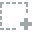
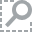
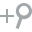
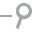
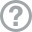
...
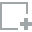
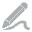
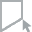
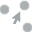
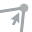

In [143]:
plot(balance_agg)

In [144]:
# merge balance_agg of loans data as a first aggregation step
previous = previous.merge(balance_agg, how='left', on='SK_ID_PREV')

In [145]:
# Days 365.243 values -> nan
previous['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
previous['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
previous['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
previous['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
previous['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
# Add feature: value ask / value received percentage
previous['N_APP_CREDIT_RATIO'] = previous['AMT_APPLICATION'] / previous['AMT_CREDIT']
previous['N_ADJ_CREDIT_RATIO'] = (previous['AMT_APPLICATION'] - previous['AMT_CREDIT']) / previous['AMT_APPLICATION']
previous['N_ADJ_INTEREST_EVAL'] = (previous['AMT_CREDIT'] -  previous['AMT_GOODS_PRICE']) / previous['AMT_GOODS_PRICE']
previous['N_CREDIT_PROLONG_RATIO'] = (previous['DAYS_LAST_DUE'] - previous['DAYS_LAST_DUE_1ST_VERSION']) / (previous['DAYS_FIRST_DUE'] - previous['DAYS_LAST_DUE_1ST_VERSION'])

In [146]:
previous.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',
       'RATE_INTEREST_PRIVILEGED', 'NAME_CASH_LOAN_PURPOSE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_PAYMENT_TYPE',
       'CODE_REJECT_REASON', 'NAME_TYPE_SUITE', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION',
       'DAYS_LAST_DUE', 'DAYS_TERMINATION', 'NFLAG_INSURED_ON_APPROVAL',
       'INS_N_PREV_CNT_PROLONG', 'INS_N_PREV_INS_AMT_MAX_OVERDUE',
       'INS_N_PREV_CNT_TOT_INSTALMENT', 'INS_N_PREV_L

In [147]:
# Preprocess previous_applications.csv
def previous_applications(prev, num_rows = None, nan_as_category = True):
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'N_APP_CREDIT_RATIO': ['min', 'max', 'mean', 'var'],
        'N_ADJ_CREDIT_RATIO': ['min', 'max', 'mean', 'var'],
        'N_ADJ_INTEREST_EVAL': ['min', 'max', 'mean', 'var'],
        'N_CREDIT_PROLONG_RATIO': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
        'INS_N_PREV_CNT_PROLONG': ['mean', 'sum'],
        'INS_N_PREV_INS_AMT_MAX_OVERDUE': ['min', 'max', 'mean'],
        'INS_N_PREV_CNT_TOT_INSTALMENT': ['mean', 'sum'],
        'INS_N_PREV_LAST_DAYS_INSTALMENT': ['mean'],
        'INS_N_PREV_EARLINESS_OVERDUE_RATIO': ['min', 'max', 'mean'],
        'INS_N_PREV_LOAN_AGE': ['mean', 'sum'],
        'NC_LOAN_TERM': ['min', 'max', 'mean', 'sum', 'var'],
        'NC_EARLINESS_OVERDUE_RATIO': ['min', 'max', 'mean', 'sum', 'var'],
        'NC_LOAN_AGE': ['min', 'max', 'mean', 'sum', 'var']
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    gc.enable()
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

In [148]:
ski_id_previous = previous_applications(previous, num_rows=None)

### Aggregate over Bureau & Bureau_balance

We compute info from bureau_balance

In [149]:
bureau.columns

Index(['SK_ID_CURR', 'SK_ID_BUREAU', 'CREDIT_ACTIVE', 'CREDIT_CURRENCY',
       'DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'DAYS_CREDIT_ENDDATE',
       'DAYS_ENDDATE_FACT', 'AMT_CREDIT_MAX_OVERDUE', 'CNT_CREDIT_PROLONG',
       'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT',
       'AMT_CREDIT_SUM_OVERDUE', 'CREDIT_TYPE', 'DAYS_CREDIT_UPDATE',
       'AMT_ANNUITY'],
      dtype='object')


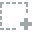
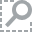
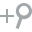
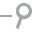
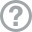
...
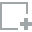
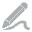
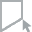
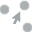
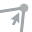

In [150]:
plot_missing(bureau)

In [151]:
# manual feature engineering for bureau_balance and bureau

In [152]:
bureau_balance.sample(1)

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
24403102,6702093,-24,X


In [153]:
# to get earliness of overdue we need to catch min of MONTHS_BALANCE out of !=C, X, or 0 STATUS
focus_bureau_balance = bureau_balance[bureau_balance['STATUS'] != 'C']
focus_bureau_balance = focus_bureau_balance[focus_bureau_balance['STATUS'] != 'X']
focus_bureau_balance = focus_bureau_balance[focus_bureau_balance['STATUS'] != '0']
focus_bureau_balance_agg = focus_bureau_balance.groupby(
    'SK_ID_BUREAU',
    as_index=False).agg(
    {'MONTHS_BALANCE': ['min']})
focus_bureau_balance_agg.columns = [
    'SK_ID_BUREAU',
    'N_BUR_EARLIER_OVERDUE']
bureau = bureau.merge(focus_bureau_balance_agg, how='left', on='SK_ID_BUREAU')

In [154]:
# get credit AGE in months since closure
closing_bureau_balance = bureau_balance[bureau_balance['STATUS'] == 'C']
closing_bureau_balance_agg = closing_bureau_balance.groupby(
    'SK_ID_BUREAU',
    as_index=False).agg(
    {'STATUS': ['count']})
closing_bureau_balance_agg.columns = [
    'SK_ID_BUREAU',
    'N_CREDIT_CLOSING_MONTHS']
bureau = bureau.merge(closing_bureau_balance_agg, how='left', on='SK_ID_BUREAU')

In [155]:
# to get duration of bureau credit 
term_bureau_balance = bureau_balance[bureau_balance['STATUS'] != 'C']
term_bureau_balance = term_bureau_balance[term_bureau_balance['STATUS'] != 'X']
term_bureau_balance_agg = term_bureau_balance.groupby(
    'SK_ID_BUREAU',
    as_index=False).agg(
    {'MONTHS_BALANCE': ['min']})
term_bureau_balance_agg.columns = [
    'SK_ID_BUREAU',
    'N_BUR_START_OBSERVED']
bureau = bureau.merge(term_bureau_balance_agg, how='left', on='SK_ID_BUREAU')

In [156]:
bureau['N_BUR_EARLINESS_OVERDUE_RATIO'] = bureau['N_BUR_EARLIER_OVERDUE'] / bureau['N_BUR_START_OBSERVED']

In [157]:
bureau['N_BUR_EARLINESS_OVERDUE_RATIO'].describe()

count    98593.000000
mean     0.738348    
std      0.259061    
min     -0.000000    
25%      0.625000    
50%      0.833333    
75%      0.933333    
max      1.000000    
Name: N_BUR_EARLINESS_OVERDUE_RATIO, dtype: float64

In [158]:
bureau.drop(columns=['N_BUR_EARLIER_OVERDUE'], inplace=True)

In [159]:
bureau['N_BUR_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)

In [160]:
bureau['N_BUR_AMT_CREDIT_DEBT_RATE'] = bureau['AMT_CREDIT_SUM_DEBT'] / (1 + bureau['AMT_CREDIT_SUM'])

In [161]:
# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(bureau, bb, num_rows = None, nan_as_category = True):
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category) 
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    print(bb_aggregations)
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    gc.enable()
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BUR_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    gc.enable()
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    gc.enable()
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

In [162]:
bureau = bureau_and_balance(bureau, bureau_balance, num_rows=None)

{'MONTHS_BALANCE': ['min', 'max', 'size'], 'STATUS_0': ['mean'], 'STATUS_1': ['mean'], 'STATUS_2': ['mean'], 'STATUS_3': ['mean'], 'STATUS_4': ['mean'], 'STATUS_5': ['mean'], 'STATUS_C': ['mean'], 'STATUS_X': ['mean'], 'STATUS_nan': ['mean']}


### Treat Applications

In [163]:
any_applications = any_applications[any_applications['CODE_GENDER'] != 'XNA']


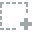
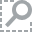
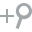
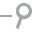
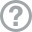
...
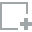
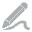
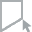
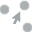
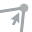

In [164]:
plot_missing(any_applications)

In [165]:
any_applications['YEARS_BIRTH'] = - any_applications['DAYS_BIRTH'] / 365


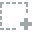
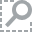
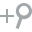
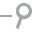
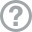
...
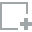
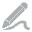
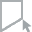
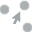
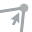

In [166]:
plot(any_applications['YEARS_BIRTH'])

In [167]:
any_applications['OCCUPATION_TYPE'] = any_applications['OCCUPATION_TYPE'].fillna(any_applications['NAME_INCOME_TYPE'])

In [168]:
any_applications['NAME_INCOME_TYPE'].unique()

array(['Working', 'State servant', 'Commercial associate', 'Pensioner',
       'Unemployed', 'Student', 'Businessman', 'Maternity leave'],
      dtype=object)

In [169]:
any_applications['OCCUPATION_TYPE'].unique()

array(['Laborers', 'Core staff', 'Accountants', 'Managers', 'Pensioner',
       'Drivers', 'Sales staff', 'Cleaning staff', 'Cooking staff',
       'State servant', 'Commercial associate', 'Private service staff',
       'Working', 'Medicine staff', 'Security staff',
       'High skill tech staff', 'Waiters/barmen staff',
       'Low-skill Laborers', 'Realty agents', 'Secretaries', 'IT staff',
       'HR staff', 'Unemployed', 'Student', 'Maternity leave',
       'Businessman'], dtype=object)

In [170]:
pensioner = any_applications[any_applications['NAME_INCOME_TYPE'] == 'Pensioner']
pensioner['YEARS_BIRTH'].describe()

count    64635.000000
mean     59.749670   
std      5.475207    
min      21.071233   
25%      57.082192   
50%      60.408219   
75%      63.480822   
max      69.120548   
Name: YEARS_BIRTH, dtype: float64

In [171]:
# NaN values for DAYS_EMPLOYED: 365.243 -> nan
any_applications['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
# Some simple new features (percentages)
any_applications['N_DAYS_EMPLOYED_RATIO'] = any_applications['DAYS_EMPLOYED'] / any_applications['DAYS_BIRTH']
any_applications['N_INCOME_CREDIT_RATIO'] = any_applications['AMT_INCOME_TOTAL'] / any_applications['AMT_CREDIT']
any_applications['N_INCOME_PER_PERSON'] = any_applications['AMT_INCOME_TOTAL'] / any_applications['CNT_FAM_MEMBERS']
any_applications['N_ANNUITY_INCOME_RATIO'] = any_applications['AMT_ANNUITY'] / any_applications['AMT_INCOME_TOTAL']
any_applications['N_CREDIT_TERM'] = any_applications['AMT_ANNUITY'] / any_applications['AMT_CREDIT']

In [172]:
any_applications.drop(columns=['DAYS_BIRTH'], inplace=True)

In [173]:
# Preprocess application_train.csv and application_test.csv
def application_train_test(df, num_rows=None, nan_as_category=False): 
    # Categorical features with Binary encode (0 or 1; two categories)
    df = label_encoder(df)
    # Categorical features with One-Hot encode
    df, cat_cols = one_hot_encoder(df, nan_as_category)    
    gc.collect()
    return df, cat_cols

In [174]:
application, catApp = application_train_test(any_applications, num_rows=None)

4 columns were label encoded. ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']


In [176]:
application.shape

(356251, 258)

In [177]:
# merge to target for corr study
app_target = application[application['TARGET'].notna()]
app_target_corrs = target_corrs(app_target)

In [178]:
app_target_corrs.head(20)

,feature,abs_corr
34,EXT_SOURCE_3,0.178926
33,EXT_SOURCE_2,0.160471
32,EXT_SOURCE_1,0.155317
112,YEARS_BIRTH,0.078242
12,DAYS_EMPLOYED,0.074957
113,N_DAYS_EMPLOYED_RATIO,0.067952
24,REGION_RATING_CLIENT_W_CITY,0.060895
23,REGION_RATING_CLIENT,0.058901
132,NAME_INCOME_TYPE_Working,0.057483
134,NAME_EDUCATION_TYPE_Higher education,0.056593


### saving truncated EDA-FE results

In [28]:
'''
# créer un csv pour continuation
application.to_csv('Data/application_trunc.csv', index=False)
'''

In [ ]:
STOP

### Merge data

In [182]:
set(previous.columns).intersection(set(application.columns))

{'AMT_ANNUITY',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'HOUR_APPR_PROCESS_START',
 'NAME_CONTRACT_TYPE',
 'SK_ID_CURR'}

In [179]:
gc.enable()
print("initial shape:", application.shape)
application = application.join(bureau, how='left', on='SK_ID_CURR')
del bureau
print("with bureau and balance agg:", application.shape)

initial shape: (356251, 258)
with bureau and balance agg: (356251, 374)


ValueError: columns overlap but no suffix specified: Index(['SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'HOUR_APPR_PROCESS_START'],
      dtype='object')

In [183]:
application = application.join(previous, how='left', on='SK_ID_CURR', rsuffix='_PREV')
del previous
print("with previous agg:", application.shape)

with previous agg: (356251, 424)


ValueError: columns overlap but no suffix specified: Index(['SK_ID_CURR', 'SK_ID_PREV', 'NAME_CONTRACT_STATUS'], dtype='object')

In [185]:
application = application.join(sk_id_focus_credit_balance, how='left', on='SK_ID_CURR')
del sk_id_focus_credit_balance
print("with credit balance agg", application.shape)

with credit balance agg (356251, 433)


In [188]:
sk_id_card_balance.columns.tolist()

['SK_ID_CURR',
 'CC_MONTHS_BALANCE_MIN',
 'CC_MONTHS_BALANCE_MAX',
 'CC_MONTHS_BALANCE_MEAN',
 'CC_MONTHS_BALANCE_SUM',
 'CC_MONTHS_BALANCE_VAR',
 'CC_AMT_BALANCE_MIN',
 'CC_AMT_BALANCE_MAX',
 'CC_AMT_BALANCE_MEAN',
 'CC_AMT_BALANCE_SUM',
 'CC_AMT_BALANCE_VAR',
 'CC_AMT_CREDIT_LIMIT_ACTUAL_MIN',
 'CC_AMT_CREDIT_LIMIT_ACTUAL_MAX',
 'CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN',
 'CC_AMT_CREDIT_LIMIT_ACTUAL_SUM',
 'CC_AMT_CREDIT_LIMIT_ACTUAL_VAR',
 'CC_AMT_DRAWINGS_ATM_CURRENT_MIN',
 'CC_AMT_DRAWINGS_ATM_CURRENT_MAX',
 'CC_AMT_DRAWINGS_ATM_CURRENT_MEAN',
 'CC_AMT_DRAWINGS_ATM_CURRENT_SUM',
 'CC_AMT_DRAWINGS_ATM_CURRENT_VAR',
 'CC_AMT_DRAWINGS_CURRENT_MIN',
 'CC_AMT_DRAWINGS_CURRENT_MAX',
 'CC_AMT_DRAWINGS_CURRENT_MEAN',
 'CC_AMT_DRAWINGS_CURRENT_SUM',
 'CC_AMT_DRAWINGS_CURRENT_VAR',
 'CC_AMT_DRAWINGS_OTHER_CURRENT_MIN',
 'CC_AMT_DRAWINGS_OTHER_CURRENT_MAX',
 'CC_AMT_DRAWINGS_OTHER_CURRENT_MEAN',
 'CC_AMT_DRAWINGS_OTHER_CURRENT_SUM',
 'CC_AMT_DRAWINGS_OTHER_CURRENT_VAR',
 'CC_AMT_DRAWINGS_POS_CURRENT

In [189]:
application.columns.tolist()

['index',
 'SK_ID_CURR',
 'TARGET',
 'NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'NONLIVING

In [186]:
application = application.join(sk_id_card_balance, how='left', on='SK_ID_CURR')
del sk_id_card_balance
print("with card balance agg", application.shape)

ValueError: columns overlap but no suffix specified: Index(['SK_ID_CURR'], dtype='object')

In [ ]:
application = application.join(sk_id_installments, how='left', on='SK_ID_CURR')
del sk_id_installments
print("with installments agg", application.shape)

In [ ]:
application = application.join(sk_id_installments_agg, how='left', on='SK_ID_CURR')
del sk_id_installments_agg
print("with sk_id_installments_agg agg", application.shape)
gc.collect()

In [45]:
application.sample(3)

,index,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,...,CC_NAME_CONTRACT_STATUS_Sent proposal_MEAN,CC_NAME_CONTRACT_STATUS_Sent proposal_SUM,CC_NAME_CONTRACT_STATUS_Sent proposal_VAR,CC_NAME_CONTRACT_STATUS_Signed_MIN,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_MEAN,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MIN,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR,CC_COUNT,INS_NUM_INSTALMENT_VERSION_MAX,INS_NUM_INSTALMENT_VERSION_NUNIQUE,INS_NUM_INSTALMENT_NUMBER_MAX,INS_DAYS_INSTALMENT_MAX,INS_N_INS_DPD_MAX,INS_N_INS_DPD_MEAN,INS_N_INS_DPD_SUM,INS_N_INS_DBD_MAX,INS_N_INS_DBD_MEAN,INS_N_INS_DBD_SUM,INS_N_INS_AMT_OVERDUE_MAX,INS_N_INS_AMT_OVERDUE_MEAN,INS_N_INS_AMT_OVERDUE_SUM,INS_N_INS_AMT_OVERDUE_VAR,INS_N_INS_AMT_PREPAYED_MAX,INS_N_INS_AMT_PREPAYED_MEAN,INS_N_INS_AMT_PREPAYED_SUM,INS_N_INS_AMT_PREPAYED_VAR,INS_N_AMT_OVERDUE_RATIO_MAX,INS_N_AMT_OVERDUE_RATIO_MEAN,INS_N_AMT_OVERDUE_RATIO_SUM,INS_N_AMT_OVERDUE_RATIO_VAR,INS_AMT_INSTALMENT_MAX,INS_AMT_INSTALMENT_MEAN,INS_AMT_INSTALMENT_SUM,INS_AMT_PAYMENT_MIN,INS_AMT_PAYMENT_MAX,INS_AMT_PAYMENT_MEAN,INS_AMT_PAYMENT_SUM,INS_DAYS_ENTRY_PAYMENT_MAX,INS_DAYS_ENTRY_PAYMENT_MEAN,INS_DAYS_ENTRY_PAYMENT_SUM,INS_N_STATUS_0_MEAN,INS_N_STATUS_0_COUNT,INS_N_STATUS_1_MEAN,INS_N_STATUS_1_COUNT,INS_N_STATUS_2_MEAN,INS_N_STATUS_2_COUNT,INS_N_STATUS_3_MEAN,INS_N_STATUS_3_COUNT,INS_N_STATUS_4_MEAN,INS_N_STATUS_4_COUNT,INS_N_STATUS_5_MEAN,INS_N_STATUS_5_COUNT,INS_N_STATUS_nan_MEAN,INS_N_STATUS_nan_COUNT,INSTAL_COUNT
318264,10753,178095,NaN,0,0,0,1,0,81000.0,330804.0,14035.5,202500.0,0.022625,-14180,-1592.0,-8197.0,-4218,NaN,1,1,0,1,1,1,2.0,2,2,11,0,0,0,0,0,0,0.432430,0.600795,0.189595,0.0124,NaN,0.9672,0.5512,NaN,0.0,0.0345,0.0417,0.0833,NaN,NaN,0.0117,NaN,0.0,0.0126,NaN,0.9672,0.5688,NaN,0.0,0.0345,0.0417,0.0833,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44.0,4.0,4.0,18.0,-18.0,3.0,0.225352,16.0,120.0,13.591549,965.0,16575.885,1005.526268,71392.365,1.241191e+07,120886.38,1901.408451,135000.0,2.079432e+08,0.991635,0.084498,5.99939,0.071415,142016.130,13538.984577,961267.905,138.825,142016.130,14434.866761,1024875.54,-17.0,-1054.211268,-74849.0,0.915493,71.0,0.084507,71.0,0.0,71.0,0.0,71.0,0.0,71.0,0.0,71.0,0.0,71.0,71.0
116461,116461,235056,0.0,0,0,0,1,1,270000.0,1288350.0,37800.0,1125000.0,0.018029,-16741,-4768.0,-4099.0,-284,NaN,1,1,1,1,1,0,3.0,3,3,8,0,0,0,0,0,0,0.378751,0.425575,0.372334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,71.0,2.0,3.0,117.0,-20.0,19.0,0.900000,144.0,34.0,5.056250,809.0,46242.450,2152.469250,344395.080,6.264490e+07,0.00,0.000000,0.0,0.000000e+00,0.988901,0.087495,13.99920,0.066060,1187169.795,19996.180875,3199388.940,0.450,1187169.795,17843.711625,2854993.86,-20.0,-1253.943750,-200631.0,0.881250,160.0,0.118750,160.0,0.0,160.0,0.0,160.0,0.0,160.0,0

In [175]:
application

,index,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,...,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11,ORGANIZATION_TYPE_Industry: type 12,ORGANIZATION_TYPE_Industry: type 13,ORGANIZATION_TYPE_Industry: type 2,ORGANIZATION_TYPE_Industry: type 3,ORGANIZATION_TYPE_Industry: type 4,ORGANIZATION_TYPE_Industry: type 5,ORGANIZATION_TYPE_Industry: type 6,ORGANIZATION_TYPE_Industry: type 7,ORGANIZATION_TYPE_Industry: type 8,ORGANIZATION_TYPE_Industry: type 9,ORGANIZATION_TYPE_Insurance,ORGANIZATION_TYPE_Kindergarten,ORGANIZATION_TYPE_Legal Services,ORGANIZATION_TYPE_Medicine,ORGANIZATION_TYPE_Military,ORGANIZATION_TYPE_Mobile,ORGANIZATION_TYPE_Other,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security Ministries,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade: type 1,ORGANIZATION_TYPE_Trade: type 2,ORGANIZATION_TYPE_Trade: type 3,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University,ORGANIZATION_TYPE_XNA,FONDKAPREMONT_MODE_not specified,FONDKAPREMONT_MODE_org spec account,FONDKAPREMONT_MODE_reg oper account,FONDKAPREMONT_MODE_reg oper spec account,HOUSETYPE_MODE_block of flats,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,0,100002,1.0,0,1,0,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0
1,1,100003,0.0,0,0,0,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,1,0
2,2,100004,0.0,1,1,1,1,0,67500.0,135000.0,6750.0,135000.0,0.010032,-225.0,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [46]:
# créer un csv pour continuation
application.to_csv('aggregated.csv', index=False)

In [50]:
print('application :')
application_conv = convert_types(application, print_info=True)

application :
Original Memory Usage: 2.11 gb.
New Memory Usage: 1.13 gb.


In [51]:
# créer un csv pour continuation
application.to_csv('aggregated_opt.csv', index=False)

## Examine Missing Values

Next we can look at the number and percentage of missing values in each column. 

### Understanding missing values

As we will have to impute missing values, we should consider understanding why they are missing.

In [10]:
missing_values = missing_values_table(application)
missing_values.head(20)

Your selected dataframe has 857 columns.
There are 677 columns that have missing values.


,Missing Values,% of Total Values
REFUSED_N_PREV_LOAN_AGE_MEAN,356251,100.0
REFUSED_N_PREV_EARLINESS_OVERDUE_RATIO_MEAN,356251,100.0
REFUSED_N_PREV_EARLINESS_OVERDUE_RATIO_MAX,356251,100.0
REFUSED_N_PREV_EARLINESS_OVERDUE_RATIO_MIN,356251,100.0
REFUSED_N_PREV_INS_AMT_MAX_OVERDUE_MEAN,356251,100.0
REFUSED_N_PREV_LAST_DAYS_INSTALMENT_MEAN,356251,100.0
REFUSED_N_PREV_INS_AMT_MAX_OVERDUE_MAX,356251,100.0
REFUSED_N_PREV_CNT_TOT_INSTALMENT_MEAN,356251,100.0
REFUSED_N_PREV_INS_AMT_MAX_OVERDUE_MIN,356251,100.0
REFUSED_N_PREV_CNT_PROLONG_MEAN,356251,100.0


In [11]:
full_missing_values = list(missing_values.index[missing_values['% of Total Values'] > 90])
len(full_missing_values)

10

## Cleaning Application

In [53]:
# Number of each type of column
application.dtypes.value_counts()

float32    682
uint8      119
int64       34
bool        19
int32        3
dtype: int64

Most of the categorical variables have a relatively small number of unique entries. We will need to find a way to deal with these categorical variables! 

The training and testing datasets now have the same features which is required for machine learning. The number of features has grown significantly due to one-hot encoding. At some point we probably will want to try [dimensionality reduction (removing features that are not relevant)](https://en.wikipedia.org/wiki/Dimensionality_reduction) to reduce the size of the datasets.

## Correlations

Now that we have dealt with the categorical variables and the outliers, let's continue with the EDA. One way to try and understand the data is by looking for correlations between the features and the target. We can calculate the Pearson correlation coefficient between every variable and the target using the `.corr` dataframe method.

The correlation coefficient is not the greatest method to represent "relevance" of a feature, but it does give us an idea of possible relationships within the data. Some [general interpretations of the absolute value of the correlation coefficent](http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf) are:


* .00-.19 “very weak”
*  .20-.39 “weak”
*  .40-.59 “moderate”
*  .60-.79 “strong”
* .80-1.0 “very strong”


In [104]:
# Find correlations with the target and sort
df_max_profit_train = df_max_profit[df_max_profit['TARGET'].notnull()]
correlations = application.corr()['TARGET'].sort_values()

# Display correlations
print('Most Positive Correlations:\n', correlations.tail(15))
print('\nMost Negative Correlations:\n', correlations.head(15))

Most Positive Correlations:
 FLAG_DOCUMENT_3                                      0.044346
REG_CITY_NOT_LIVE_CITY                               0.044395
FLAG_EMP_PHONE                                       0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
REGION_RATING_CLIENT                                 0.058899
REGION_RATING_CLIENT_W_CITY                          0.060893
DAYS_EMPLOYED                                        0.074958
DAYS_BIRTH                                           0.078239
TARGET                                               1.000000
DAYS_EMPLOYED_ANOM                                  NaN      
Name: TARGET, dtype: float64

Most Negati

Let's take a look at some of more significant correlations: the `DAYS_BIRTH` is the most positive correlation. (except for `TARGET` because the correlation of a variable with itself is always 1!) Looking at the documentation, `DAYS_BIRTH` is the age in days of the client at the time of the loan in negative days (for whatever reason!). The correlation is positive, but the value of this feature is actually negative, meaning that as the client gets older, they are less likely to default on their loan (ie the target == 0). That's a little confusing, so we will take the absolute value of the feature and then the correlation will be negative.

### Effect of Age on Repayment

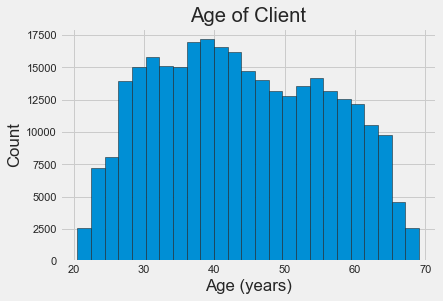

In [106]:
# Set the style of plots
plt.style.use('fivethirtyeight')

# Plot the distribution of ages in years
plt.hist(application['DAYS_BIRTH'] / 365, edgecolor = 'k', bins = 25)
plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');

By itself, the distribution of age does not tell us much other than that there are no outliers as all the ages are reasonable. To visualize the effect of the age on the target, we will next make a [kernel density estimation plot](https://en.wikipedia.org/wiki/Kernel_density_estimation) (KDE) colored by the value of the target. A [kernel density estimate plot shows the distribution of a single variable](https://chemicalstatistician.wordpress.com/2013/06/09/exploratory-data-analysis-kernel-density-estimation-in-r-on-ozone-pollution-data-in-new-york-and-ozonopolis/) and can be thought of as a smoothed histogram (it is created by computing a kernel, usually a Gaussian, at each data point and then averaging all the individual kernels to develop a single smooth curve). We will use the seaborn `kdeplot` for this graph.

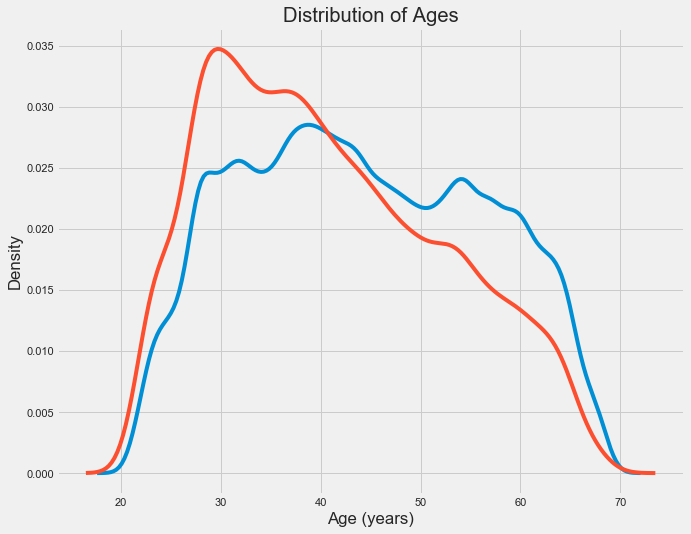

In [108]:
plt.figure(figsize = (10, 8))

# KDE plot of loans that were repaid on time
sns.kdeplot(application.loc[application['TARGET'] == 0, 'DAYS_BIRTH'] / 365, label = 'target == 0')

# KDE plot of loans which were not repaid on time
sns.kdeplot(application.loc[application['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label = 'target == 1')

# Labeling of plot
plt.xlabel('Age (years)'); plt.ylabel('Density'); plt.title('Distribution of Ages');

The target == 1 curve skews towards the younger end of the range. Although this is not a significant correlation (-0.07 correlation coefficient), this variable is likely going to be useful in a machine learning model because it does affect the target. Let's look at this relationship in another way: average failure to repay loans by age bracket. 

To make this graph, first we `cut` the age category into bins of 5 years each. Then, for each bin, we calculate the average value of the target, which tells us the ratio of loans that were not repaid in each age category.

In [109]:
# Age information into a separate dataframe
age_data = application[['TARGET', 'DAYS_BIRTH']]
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

# Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))
age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,True,9461,25.920548,"(25.0, 30.0]"
1,False,16765,45.931507,"(45.0, 50.0]"
2,False,19046,52.180822,"(50.0, 55.0]"
3,False,19005,52.068493,"(50.0, 55.0]"
4,False,19932,54.608219,"(50.0, 55.0]"
5,False,16941,46.413699,"(45.0, 50.0]"
6,False,13778,37.747945,"(35.0, 40.0]"
7,False,18850,51.643836,"(50.0, 55.0]"
8,False,20099,55.065753,"(55.0, 60.0]"
9,False,14469,39.641096,"(35.0, 40.0]"


In [110]:
# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111436,10155.219250,27.822518
"(30.0, 35.0]",0.102814,11854.848377,32.479037
"(35.0, 40.0]",0.089414,13707.908253,37.555913
"(40.0, 45.0]",0.078491,15497.661233,42.459346
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055314,20984.262742,57.491131
"(60.0, 65.0]",0.052737,22780.547460,62.412459


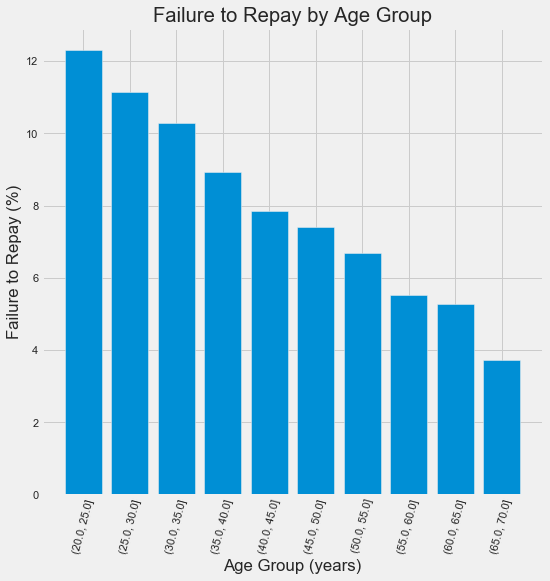

In [111]:
plt.figure(figsize = (8, 8))

# Graph the age bins and the average of the target as a bar plot
plt.bar(age_groups.index.astype(str), 100 * age_groups['TARGET'])

# Plot labeling
plt.xticks(rotation = 75); plt.xlabel('Age Group (years)'); plt.ylabel('Failure to Repay (%)')
plt.title('Failure to Repay by Age Group');

There is a clear trend: younger applicants are more likely to not repay the loan! The rate of failure to repay is above 10% for the youngest three age groups and beolow 5% for the oldest age group.

This is information that could be directly used by the bank: because younger clients are less likely to repay the loan, maybe they should be provided with more guidance or financial planning tips. This does not mean the bank should discriminate against younger clients, but it would be smart to take precautionary measures to help younger clients pay on time.

### Exterior Sources

The 3 variables with the strongest negative correlations with the target are `EXT_SOURCE_1`, `EXT_SOURCE_2`, and `EXT_SOURCE_3`.
According to the documentation, these features represent a "normalized score from external data source". I'm not sure what this exactly means, but it may be a cumulative sort of credit rating made using numerous sources of data. 

Let's take a look at these variables.

First, we can show the correlations of the `EXT_SOURCE` features with the target and with each other.

In [112]:
# Extract the EXT_SOURCE variables and show correlations
ext_data = application[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,-0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,0.205478
DAYS_BIRTH,-0.078239,0.600610,0.091996,0.205478,1.000000


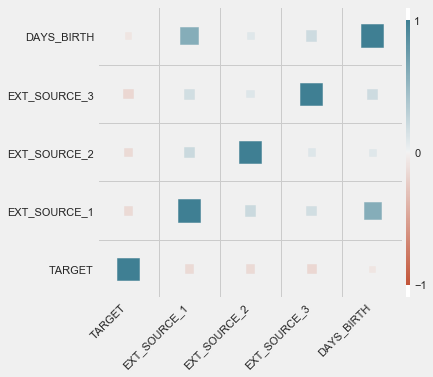

In [113]:
# calculer les corrélations entre features
corr = ext_data.corr(method='spearman')
corr = pd.melt(corr.reset_index(), id_vars='index')
corr.columns = ['x', 'y', 'value']
# visualiser les corrélations entre features
heatmap(
    x=corr['x'],
    y=corr['y'],
    size=corr['value'].abs(),
    color=corr['value']
)

All three `EXT_SOURCE` featureshave negative correlations with the target, indicating that as the value of the `EXT_SOURCE` increases, the client is more likely to repay the loan. We can also see that `DAYS_BIRTH` is positively correlated with `EXT_SOURCE_1` indicating that maybe one of the factors in this score is the client age.

Next we can look at the distribution of each of these features colored by the value of the target. This will let us visualize the effect of this variable on the target.

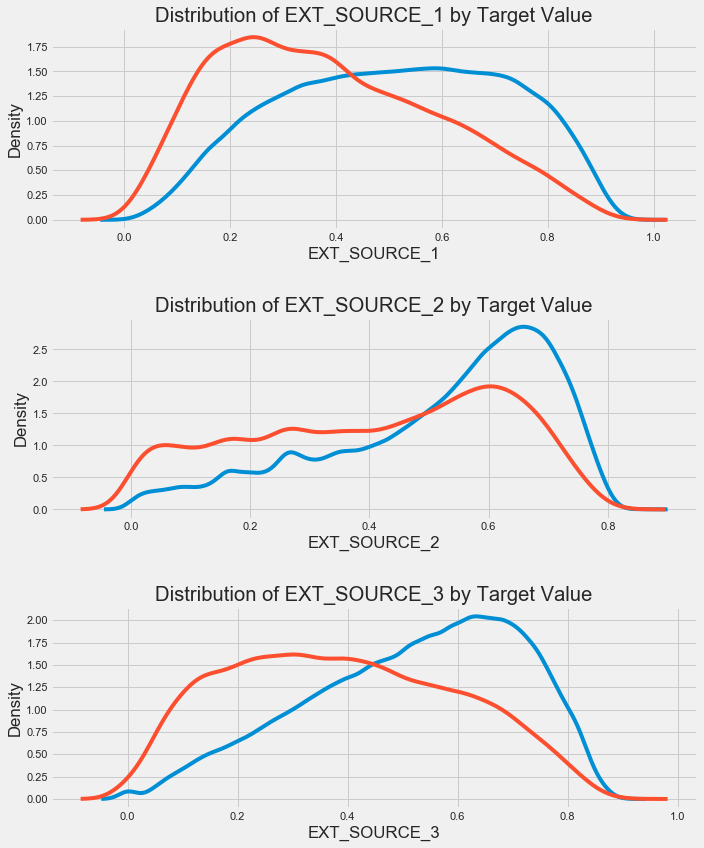

In [114]:
plt.figure(figsize = (10, 12))

# iterate through the sources
for i, source in enumerate(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']):
    
    # create a new subplot for each source
    plt.subplot(3, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(application.loc[application['TARGET'] == 0, source], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(application.loc[application['TARGET'] == 1, source], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % source)
    plt.xlabel('%s' % source); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)
    

`EXT_SOURCE_3` displays the greatest difference between the values of the target. We can clearly see that this feature has some relationship to the likelihood of an applicant to repay a loan. The relationship is not very strong (in fact they are all [considered very weak](http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf), but these variables will still be useful for a machine learning model to predict whether or not an applicant will repay a loan on time.

## Pairs Plot

As a final exploratory plot, we can make a pairs plot of the `EXT_SOURCE` variables and the `DAYS_BIRTH` variable. The [Pairs Plot](https://towardsdatascience.com/visualizing-data-with-pair-plots-in-python-f228cf529166) is a great exploration tool because it lets us see relationships between multiple pairs of variables as well as distributions of single variables. Here we are using the seaborn visualization library and the PairGrid function to create a Pairs Plot with scatterplots on the upper triangle, histograms on the diagonal, and 2D kernel density plots and correlation coefficients on the lower triangle.

If you don't understand this code, that's all right! Plotting in Python can be overly complex, and for anything beyond the simplest graphs, I usually find an existing implementation and adapt the code (don't repeat yourself)! 

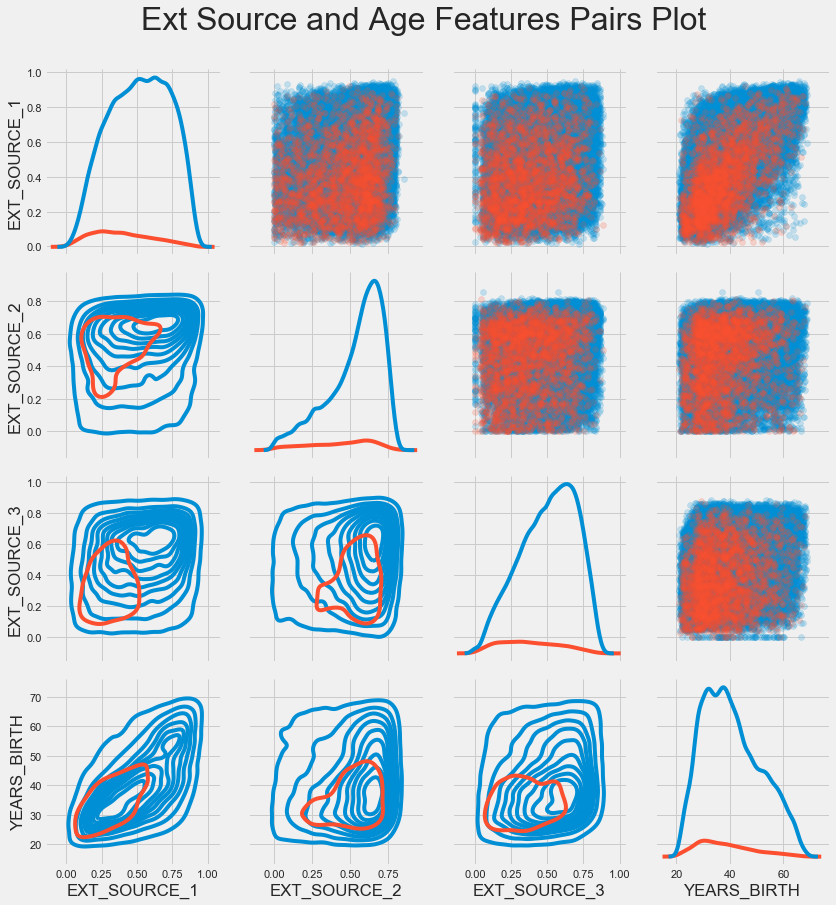

In [115]:
# Copy the data for plotting
plot_data = ext_data.drop(columns = ['DAYS_BIRTH']).copy()

# Add in the age of the client in years
plot_data['YEARS_BIRTH'] = age_data['YEARS_BIRTH']

# Drop na values and limit to first 100000 rows
plot_data = plot_data.dropna().loc[:100000, :]

# Function to calculate correlation coefficient between two columns
def corr_func(x, y, **kwargs):
    r = np.corrcoef(x, y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
                xy=(.2, .8), xycoords=ax.transAxes,
                size = 20)

# Create the pairgrid object
grid = sns.PairGrid(data = plot_data, size = 3, diag_sharey=False,
                    hue = 'TARGET', 
                    vars = [x for x in list(plot_data.columns) if x != 'TARGET'])

# Upper is a scatter plot
grid.map_upper(plt.scatter, alpha = 0.2)

# Diagonal is a histogram
grid.map_diag(sns.kdeplot)

# Bottom is density plot
grid.map_lower(sns.kdeplot, cmap = plt.cm.OrRd_r);

plt.suptitle('Ext Source and Age Features Pairs Plot', size = 32, y = 1.05);

In this plot, the red indicates loans that were not repaid and the blue are loans that are paid. We can see the different relationships within the data. There does appear to be a moderate positive linear relationship between the `EXT_SOURCE_1` and the `DAYS_BIRTH` (or equivalently `YEARS_BIRTH`), indicating that this feature may take into account the age of the client. 

# Feature Engineering

Kaggle competitions are won by feature engineering: those win are those who can create the most useful features out of the data. (This is true for the most part as the winning models, at least for structured data, all tend to be variants on [gradient boosting](http://blog.kaggle.com/2017/01/23/a-kaggle-master-explains-gradient-boosting/)). This represents one of the patterns in machine learning: feature engineering has a greater return on investment than model building and hyperparameter tuning. [This is a great article on the subject)](https://www.featurelabs.com/blog/secret-to-data-science-success/). As Andrew Ng is fond of saying: "applied machine learning is basically feature engineering." 

While choosing the right model and optimal settings are important, the model can only learn from the data it is given. Making sure this data is as relevant to the task as possible is the job of the data scientist (and maybe some [automated tools](https://docs.featuretools.com/getting_started/install.html) to help us out).

Feature engineering refers to a geneal process and can involve both feature construction: adding new features from the existing data, and feature selection: choosing only the most important features or other methods of dimensionality reduction. There are many techniques we can use to both create features and select features.

We will do a lot of feature engineering when we start using the other data sources, but in this notebook we will try only two simple feature construction methods: 

* Polynomial features => DEAD END
* Domain knowledge features


## Domain Knowledge Features

Maybe it's not entirely correct to call this "domain knowledge" because I'm not a credit expert, but perhaps we could call this "attempts at applying limited financial knowledge". In this frame of mind, we can make a couple features that attempt to capture what we think may be important for telling whether a client will default on a loan. Here I'm going to use five features that were inspired by [this script](https://www.kaggle.com/jsaguiar/updated-0-792-lb-lightgbm-with-simple-features) by Aguiar:

* `CREDIT_INCOME_PERCENT`: the percentage of the credit amount relative to a client's income
* `ANNUITY_INCOME_PERCENT`: the percentage of the loan annuity relative to a client's income
* `CREDIT_TERM`:  the length of the payment in months (since the annuity is the monthly amount due
* `DAYS_EMPLOYED_PERCENT`: the percentage of the days employed relative to the client's age

Again, thanks to Aguiar and [his great script](https://www.kaggle.com/jsaguiar/updated-0-792-lb-lightgbm-with-simple-features) for exploring these features.



In [116]:
app_train_domain = application.copy()
# app_test_domain = app_test.copy()

app_train_domain['CREDIT_INCOME_PERCENT'] = app_train_domain['AMT_CREDIT'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['ANNUITY_INCOME_PERCENT'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['CREDIT_TERM'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_CREDIT']
app_train_domain['DAYS_EMPLOYED_PERCENT'] = app_train_domain['DAYS_EMPLOYED'] / app_train_domain['DAYS_BIRTH']

In [117]:
'''
app_test_domain['CREDIT_INCOME_PERCENT'] = app_test_domain['AMT_CREDIT'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['ANNUITY_INCOME_PERCENT'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['CREDIT_TERM'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_CREDIT']
app_test_domain['DAYS_EMPLOYED_PERCENT'] = app_test_domain['DAYS_EMPLOYED'] / app_test_domain['DAYS_BIRTH']
'''

"\napp_test_domain['CREDIT_INCOME_PERCENT'] = app_test_domain['AMT_CREDIT'] / app_test_domain['AMT_INCOME_TOTAL']\napp_test_domain['ANNUITY_INCOME_PERCENT'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_INCOME_TOTAL']\napp_test_domain['CREDIT_TERM'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_CREDIT']\napp_test_domain['DAYS_EMPLOYED_PERCENT'] = app_test_domain['DAYS_EMPLOYED'] / app_test_domain['DAYS_BIRTH']\n"

#### Visualize New Variables

We should explore these __domain knowledge__ variables visually in a graph. For all of these, we will make the same KDE plot colored by the value of the `TARGET`.

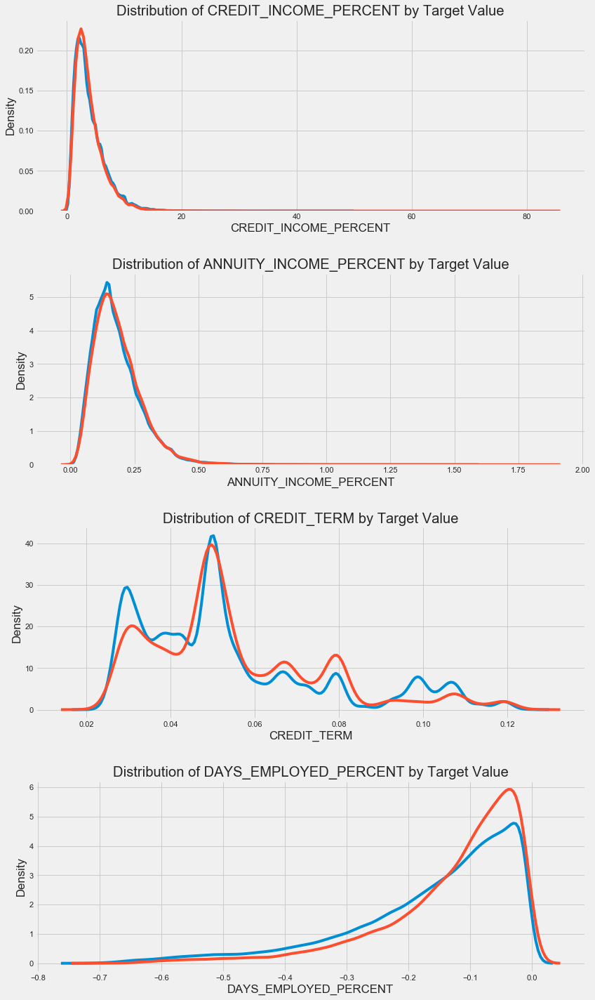

In [118]:
plt.figure(figsize = (12, 20))
# iterate through the new features
for i, feature in enumerate(['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']):
    
    # create a new subplot for each source
    plt.subplot(4, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 0, feature], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 1, feature], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % feature)
    plt.xlabel('%s' % feature); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)

It's hard to say ahead of time if these new features will be useful. The only way to tell for sure is to try them out! 